<a href="https://colab.research.google.com/github/daveveed/Geo-Data-Science/blob/main/XArray.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
%%capture
if 'google.colab' in str(get_ipython()):
    !pip install pystac-client odc-stac rioxarray dask

In [2]:
import os
import matplotlib.pyplot as plt
import pystac_client
from odc.stac import stac_load
import xarray as xr
import rioxarray as rxr

In [3]:
data_folder = 'data'
output_folder = 'output'

if not os.path.exists(data_folder):
  os.mkdir(data_folder)
if not os.path.exists(output_folder):
  os.mkdir(output_folder)

## Getting satellite imagery using STAC API

In [4]:
latitude = 27.163
longitude = 82.688
year = 2023

In [5]:
catalog = pystac_client.Client.open('https://earth-search.aws.element84.com/v1')

km2deg = 1/111
x,y = (longitude, latitude)
r = 1 * km2deg #radius to degrees
bbox = (x-r, y-r, x+r, y+r)

search = catalog.search(
    collections=['sentinel-2-c1-l2a'],
    bbox=bbox,
    datetime=f'{year}',
    query={'eo:cloud_cover': {'lt': 30}},
)
items = search.item_collection()
items

In [6]:
ds = stac_load(items, bands=['red', 'green', 'blue', 'nir'],
              resolution=10, bbox=bbox, chunks={},
               groupby='solar_day')
ds

<xarray.Dataset> Size: 21MB
Dimensions:      (y: 203, x: 182, time: 70)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
    spatial_ref  int32 4B 32644
Data variables:
    red          (time, y, x) uint16 5MB dask.array<chunksize=(1, 203, 182), meta=np.ndarray>
    green        (time, y, x) uint16 5MB dask.array<chunksize=(1, 203, 182), meta=np.ndarray>
    blue         (time, y, x) uint16 5MB dask.array<chunksize=(1, 203, 182), meta=np.ndarray>
    nir          (time, y, x) uint16 5MB dask.array<chunksize=(1, 203, 182), meta=np.ndarray>

In [7]:
%%time
ds = ds.compute()

CPU times: user 6.17 s, sys: 624 ms, total: 6.79 s
Wall time: 1min 59s


In [8]:
ds

<xarray.Dataset> Size: 21MB
Dimensions:      (y: 203, x: 182, time: 70)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
    spatial_ref  int32 4B 32644
Data variables:
    red          (time, y, x) uint16 5MB 6412 6572 6712 6832 ... 2008 2034 2050
    green        (time, y, x) uint16 5MB 6536 6592 6656 6792 ... 2092 2066 2064
    blue         (time, y, x) uint16 5MB 6612 6824 6912 6980 ... 1901 1915 1884
    nir          (time, y, x) uint16 5MB 6316 6508 6656 6756 ... 3266 3156 3154

In [14]:
da = ds.red
da

<xarray.DataArray 'red' (time: 70, y: 203, x: 182)> Size: 5MB
array([[[6412, 6572, 6712, ..., 5784, 5816, 5816],
        [6480, 6596, 6712, ..., 5828, 5816, 5828],
        [6616, 6692, 6776, ..., 5872, 5876, 5848],
        ...,
        [6392, 6444, 6528, ..., 7200, 7156, 7212],
        [6436, 6464, 6612, ..., 7176, 7224, 7264],
        [6512, 6604, 6688, ..., 7224, 7288, 7352]],

       [[2302, 2306, 2142, ..., 1807, 1838, 1848],
        [2330, 2310, 2274, ..., 1756, 1810, 1764],
        [2296, 2312, 2328, ..., 1755, 1813, 1763],
        ...,
        [1626, 1614, 1631, ..., 1653, 1606, 1611],
        [1568, 1597, 1630, ..., 1616, 1610, 1648],
        [1560, 1576, 1606, ..., 1636, 1672, 1656]],

       [[2252, 2180, 2214, ..., 1487, 1524, 1500],
        [2238, 2220, 2242, ..., 1448, 1506, 1472],
        [2138, 2222, 2194, ..., 1432, 1482, 1477],
        ...,
...
        ...,
        [1628, 1628, 1778, ..., 2302, 2274, 2252],
        [1638, 1630, 1754, ..., 2344, 2322, 2302],
        [1670, 1610, 1688, ..., 2428, 2448, 2444]],

       [[1824, 1850, 1882, ..., 1978, 1732, 1744],
        [1860, 1812, 1922, ..., 2000, 1807, 1794],
        [1988, 1922, 2009, ..., 1935, 1844, 1824],
        ...,
        [1470, 1448, 1541, ..., 2084, 2082, 2068],
        [1466, 1427, 1512, ..., 2054, 2068, 2096],
        [1447, 1442, 1488, ..., 2090, 2140, 2152]],

       [[1812, 1826, 1891, ..., 2108, 1904, 1879],
        [1902, 1833, 1934, ..., 2122, 1982, 1935],
        [2092, 1974, 2032, ..., 2018, 1934, 1930],
        ...,
        [1602, 1604, 1684, ..., 2170, 2196, 2194],
        [1606, 1562, 1610, ..., 2040, 2072, 2116],
        [1634, 1570, 1600, ..., 2008, 2034, 2050]]], dtype=uint16)
Coordinates:
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Attributes:
    nodata:   0

## selecting data

XArray provides a very powerful way to select subsets of data, using similar framework as Pandas. Similar to Panda’s loc and iloc methods, XArray provides sel and isel methods. Since DataArray dimensions have names, these methods allow you to specify which dimension to query.

Let’s select the temperature anomany values for the last time step. Since we know the index (-1) of the datam we can use isel method.

In [16]:
da.isel(time=1)

<xarray.DataArray 'red' (y: 203, x: 182)> Size: 74kB
array([[2302, 2306, 2142, ..., 1807, 1838, 1848],
       [2330, 2310, 2274, ..., 1756, 1810, 1764],
       [2296, 2312, 2328, ..., 1755, 1813, 1763],
       ...,
       [1626, 1614, 1631, ..., 1653, 1606, 1611],
       [1568, 1597, 1630, ..., 1616, 1610, 1648],
       [1560, 1576, 1606, ..., 1636, 1672, 1656]], dtype=uint16)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
    time         datetime64[ns] 8B 2023-01-18T05:21:06.614000
Attributes:
    nodata:   0

In [17]:
# to get the values
da.isel(time=-1).values

array([[1812, 1826, 1891, ..., 2108, 1904, 1879],
       [1902, 1833, 1934, ..., 2122, 1982, 1935],
       [2092, 1974, 2032, ..., 2018, 1934, 1930],
       ...,
       [1602, 1604, 1684, ..., 2170, 2196, 2194],
       [1606, 1562, 1610, ..., 2040, 2072, 2116],
       [1634, 1570, 1600, ..., 2008, 2034, 2050]], dtype=uint16)

In [18]:
# multiple query; the last pixel value
da.isel(time =-1, x=-1, y=-1)

<xarray.DataArray 'red' ()> Size: 2B
array(2050, dtype=uint16)
Coordinates:
    y            float64 8B 3.005e+06
    x            float64 8B 6.682e+05
    spatial_ref  int32 4B 32644
    time         datetime64[ns] 8B 2023-12-26T05:11:10.219000
Attributes:
    nodata:   0

In [22]:
# time values
dates = da.time.values
dates


array(['2023-01-13T05:21:06.880000000', '2023-01-18T05:21:06.614000000',
       '2023-01-23T05:21:05.552000000', '2023-02-07T05:21:07.419000000',
       '2023-02-09T05:11:12.073000000', '2023-02-12T05:21:07.542000000',
       '2023-02-14T05:11:11.668000000', '2023-02-19T05:11:10.303000000',
       '2023-02-22T05:21:06.867000000', '2023-03-01T05:11:10.619000000',
       '2023-03-04T05:21:06.040000000', '2023-03-06T05:11:16.188000000',
       '2023-03-09T05:21:13.261000000', '2023-03-11T05:11:08.720000000',
       '2023-03-24T05:21:07.945000000', '2023-03-26T05:11:16.033000000',
       '2023-04-03T05:21:08.616000000', '2023-04-05T05:11:16.355000000',
       '2023-04-08T05:21:11.786000000', '2023-04-10T05:11:13.434000000',
       '2023-04-13T05:21:09.401000000', '2023-04-18T05:21:11.018000000',
       '2023-04-23T05:21:08.563000000', '2023-04-25T05:11:15.158000000',
       '2023-05-05T05:11:15.867000000', '2023-05-10T05:11:12.717000000',
       '2023-05-13T05:21:09.142000000', '2023-05-18

In [23]:
# at this date there was no imagge
da.sel(time='2023-12-10') # also we used sel instead of isel cos the "i" is for indexing
#but since we know the time we are searching then we search it directly with using isel

<xarray.DataArray 'red' (time: 0, y: 203, x: 182)> Size: 0B
array([], shape=(0, 203, 182), dtype=uint16)
Coordinates:
  * time         (time) datetime64[ns] 0B 
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Attributes:
    nodata:   0

In [24]:
# get the nearest data to that date
da.sel(time='2023-12-10', method='nearest')

<xarray.DataArray 'red' (y: 203, x: 182)> Size: 74kB
array([[2584, 2628, 2610, ..., 2500, 2264, 2416],
       [2586, 2598, 2644, ..., 2570, 2456, 2516],
       [2616, 2602, 2598, ..., 2546, 2540, 2578],
       ...,
       [1853, 1866, 1960, ..., 2330, 2296, 2268],
       [1824, 1825, 1991, ..., 2422, 2398, 2334],
       [1844, 1838, 1979, ..., 2498, 2530, 2472]], dtype=uint16)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
    time         datetime64[ns] 8B 2023-12-09T05:21:03.902000
Attributes:
    nodata:   0

from the cell above we can see the nearest time with data was 2023-12-09

In [25]:
# range of data
da.sel(time=slice('2023-01-01', '2023-01-31'))

<xarray.DataArray 'red' (time: 3, y: 203, x: 182)> Size: 222kB
array([[[6412, 6572, 6712, ..., 5784, 5816, 5816],
        [6480, 6596, 6712, ..., 5828, 5816, 5828],
        [6616, 6692, 6776, ..., 5872, 5876, 5848],
        ...,
        [6392, 6444, 6528, ..., 7200, 7156, 7212],
        [6436, 6464, 6612, ..., 7176, 7224, 7264],
        [6512, 6604, 6688, ..., 7224, 7288, 7352]],

       [[2302, 2306, 2142, ..., 1807, 1838, 1848],
        [2330, 2310, 2274, ..., 1756, 1810, 1764],
        [2296, 2312, 2328, ..., 1755, 1813, 1763],
        ...,
        [1626, 1614, 1631, ..., 1653, 1606, 1611],
        [1568, 1597, 1630, ..., 1616, 1610, 1648],
        [1560, 1576, 1606, ..., 1636, 1672, 1656]],

       [[2252, 2180, 2214, ..., 1487, 1524, 1500],
        [2238, 2220, 2242, ..., 1448, 1506, 1472],
        [2138, 2222, 2194, ..., 1432, 1482, 1477],
        ...,
        [1526, 1536, 1563, ..., 1410, 1402, 1411],
        [1514, 1522, 1532, ..., 1425, 1452, 1424],
        [1554, 1510, 1532, ..., 1451, 1482, 1455]]], dtype=uint16)
Coordinates:
  * time         (time) datetime64[ns] 24B 2023-01-13T05:21:06.880000 ... 202...
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Attributes:
    nodata:   0

## Aggregatiing data

In [26]:
ds

<xarray.Dataset> Size: 21MB
Dimensions:      (y: 203, x: 182, time: 70)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
  * time         (time) datetime64[ns] 560B 2023-01-13T05:21:06.880000 ... 20...
    spatial_ref  int32 4B 32644
Data variables:
    red          (time, y, x) uint16 5MB 6412 6572 6712 6832 ... 2008 2034 2050
    green        (time, y, x) uint16 5MB 6536 6592 6656 6792 ... 2092 2066 2064
    blue         (time, y, x) uint16 5MB 6612 6824 6912 6980 ... 1901 1915 1884
    nir          (time, y, x) uint16 5MB 6316 6508 6656 6756 ... 3266 3156 3154

In [27]:
median = ds.median(dim='time')
median

<xarray.Dataset> Size: 1MB
Dimensions:      (y: 203, x: 182)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Data variables:
    red          (y, x) float64 296kB 2.376e+03 2.388e+03 ... 2.343e+03
    green        (y, x) float64 296kB 2.255e+03 2.245e+03 ... 2.225e+03
    blue         (y, x) float64 296kB 1.988e+03 1.976e+03 ... 1.998e+03
    nir          (y, x) float64 296kB 3.586e+03 3.528e+03 ... 3.641e+03 3.68e+03

## visualisation

XArray provides a plot.imshow() method based on Matplotlib to plot DataArrays.

Reference : xarray.plot.imshow

To visualize our Dataset, we first convert it to a DataArray using the to_array() method. All the variables will be converted to a new dimension. Since our variables are image bands, we give the name of the new dimesion as band.

In [29]:
median_da = median.to_array('band')
median_da

<xarray.DataArray (band: 4, y: 203, x: 182)> Size: 1MB
array([[[2376. , 2388. , 2408. , ..., 2273. , 2059. , 2212. ],
        [2392. , 2386. , 2399. , ..., 2234. , 2123. , 2244. ],
        [2485. , 2393. , 2376. , ..., 2130. , 2171. , 2240. ],
        ...,
        [1645.5, 1631. , 1779.5, ..., 2284. , 2222. , 2222. ],
        [1618. , 1597. , 1903. , ..., 2362. , 2318. , 2250. ],
        [1659.5, 1573. , 1874.5, ..., 2403. , 2393. , 2343. ]],

       [[2255. , 2245. , 2234. , ..., 2135. , 2028. , 2057. ],
        [2281. , 2226. , 2272. , ..., 2135. , 2058. , 2035. ],
        [2350. , 2257. , 2259. , ..., 2035. , 2053. , 1993. ],
        ...,
        [1729. , 1752. , 1875.5, ..., 2088. , 2061. , 2037. ],
        [1743.5, 1739. , 1904.5, ..., 2185. , 2133. , 2070. ],
        [1769.5, 1730.5, 1927.5, ..., 2246. , 2234. , 2225. ]],

       [[1988. , 1976. , 1994.5, ..., 1884.5, 1793.5, 1875.5],
        [1985. , 1982. , 2004. , ..., 1867.5, 1842.5, 1912. ],
        [2050. , 2004. , 1980. , ..., 1829. , 1871. , 1872. ],
        ...,
        [1516. , 1479. , 1578. , ..., 1932. , 1906.5, 1904.5],
        [1518. , 1502.5, 1672. , ..., 1981.5, 1953. , 1924.5],
        [1559.5, 1484.5, 1626.5, ..., 1992.5, 2012.5, 1998.5]],

       [[3586. , 3528. , 3537. , ..., 3858. , 3975. , 3750. ],
        [3538. , 3613. , 3588. , ..., 4019. , 3950. , 3671. ],
        [3481. , 3599. , 3682. , ..., 3880. , 3796.5, 3613.5],
        ...,
        [3528. , 3553. , 3919.5, ..., 3924. , 3902. , 3907. ],
        [3653. , 3615. , 3864. , ..., 3783. , 3795. , 3839.5],
        [3498. , 3631. , 3939. , ..., 3678. , 3641. , 3680. ]]])
Coordinates:
  * band         (band) object 32B 'red' 'green' 'blue' 'nir'
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644

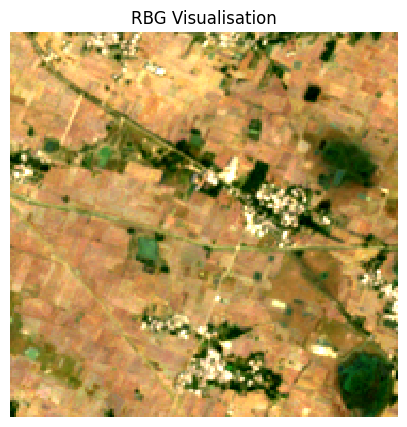

In [31]:
fig, ax = plt.subplots(1,1)
fig.set_size_inches(5,5)

median_da.sel(band=['red', 'green', 'blue']).plot.imshow(
    ax=ax,
    robust=True
)
ax.set_title('RBG Visualisation')
ax.set_axis_off()

plt.show()

In [32]:
# montly

monthly = ds.groupby('time.month').median(dim='time')
monthly

<xarray.Dataset> Size: 14MB
Dimensions:      (month: 12, y: 203, x: 182)
Coordinates:
  * month        (month) int64 96B 1 2 3 4 5 6 7 8 9 10 11 12
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Data variables:
    red          (month, y, x) float64 4MB 2.302e+03 2.306e+03 ... 2.458e+03
    green        (month, y, x) float64 4MB 2.26e+03 2.298e+03 ... 2.289e+03
    blue         (month, y, x) float64 4MB 2.062e+03 2.072e+03 ... 2.111e+03
    nir          (month, y, x) float64 4MB 3.17e+03 3.244e+03 ... 3.231e+03

In [44]:
may = monthly.sel(month=4)
may

<xarray.Dataset> Size: 1MB
Dimensions:      (y: 203, x: 182)
Coordinates:
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
    month        int64 8B 4
Data variables:
    red          (y, x) float64 296kB 2.571e+03 2.501e+03 ... 2.894e+03
    green        (y, x) float64 296kB 2.244e+03 2.171e+03 ... 2.337e+03
    blue         (y, x) float64 296kB 1.872e+03 1.863e+03 ... 1.949e+03
    nir          (y, x) float64 296kB 3.696e+03 3.494e+03 ... 3.878e+03

very important convert the data set to array before plotting

In [45]:
may_da = may.to_array('bands')
may_da

<xarray.DataArray (bands: 4, y: 203, x: 182)> Size: 1MB
array([[[2571. , 2501. , 2553. , ..., 2346. , 1962.5, 2225. ],
        [2607. , 2519. , 2576. , ..., 2222. , 2026. , 2264. ],
        [2771. , 2526. , 2445. , ..., 2078. , 2115. , 2289. ],
        ...,
        [1594. , 1583. , 1783.5, ..., 2781. , 2664. , 2614. ],
        [1482.5, 1492.5, 2039. , ..., 2991. , 2909. , 2722. ],
        [1494.5, 1417.5, 1972. , ..., 2998. , 3016. , 2894. ]],

       [[2244. , 2171. , 2204. , ..., 2095. , 1916. , 2028. ],
        [2308. , 2206. , 2228. , ..., 2046. , 1942. , 2000. ],
        [2408. , 2247. , 2166. , ..., 1927. , 1900. , 1973. ],
        ...,
        [1638. , 1628. , 1827. , ..., 2259. , 2145. , 2119. ],
        [1570. , 1575.5, 1960. , ..., 2386. , 2327. , 2213. ],
        [1653.5, 1613. , 1969.5, ..., 2414. , 2413. , 2337. ]],

       [[1871.5, 1863. , 1890. , ..., 1802. , 1564. , 1753. ],
        [1920. , 1886.5, 1910. , ..., 1690. , 1574.5, 1788. ],
        [2050. , 1889.5, 1847. , ..., 1620.5, 1644.5, 1770.5],
        ...,
        [1425. , 1378. , 1495. , ..., 1866. , 1792.5, 1773. ],
        [1364. , 1328.5, 1614.5, ..., 2012.5, 1898. , 1839.5],
        [1378.5, 1320.5, 1562. , ..., 1992.5, 2007. , 1949. ]],

       [[3696. , 3494. , 3469. , ..., 3706. , 3986. , 3485. ],
        [3804. , 3655. , 3579. , ..., 3875. , 3793. , 3139. ],
        [3835. , 3845. , 3669. , ..., 3770. , 3335. , 2957. ],
        ...,
        [3328. , 3374. , 4042. , ..., 3731. , 3540. , 3445. ],
        [3426. , 3587. , 4118. , ..., 3983. , 3870. , 3622. ],
        [3629. , 3886. , 4388. , ..., 3992. , 4023. , 3878. ]]])
Coordinates:
  * bands        (bands) object 32B 'red' 'green' 'blue' 'nir'
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
    month        int64 8B 4

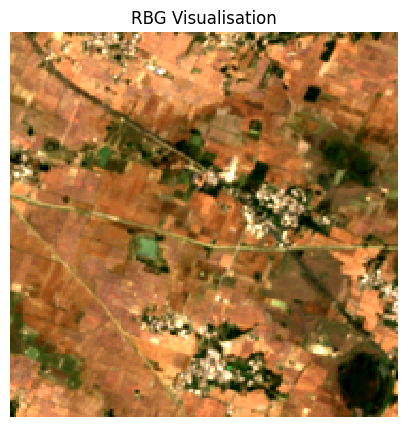

In [46]:
fig, ax = plt.subplots(1,1)
fig.set_size_inches(5,5)

may_da.sel(bands=['red', 'green', 'blue']).plot.imshow(
    ax=ax,
    robust=True
)
ax.set_title('RBG Visualisation')
ax.set_axis_off()

plt.show()

## visualising all months a once

In [47]:
monthly

<xarray.Dataset> Size: 14MB
Dimensions:      (month: 12, y: 203, x: 182)
Coordinates:
  * month        (month) int64 96B 1 2 3 4 5 6 7 8 9 10 11 12
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644
Data variables:
    red          (month, y, x) float64 4MB 2.302e+03 2.306e+03 ... 2.458e+03
    green        (month, y, x) float64 4MB 2.26e+03 2.298e+03 ... 2.289e+03
    blue         (month, y, x) float64 4MB 2.062e+03 2.072e+03 ... 2.111e+03
    nir          (month, y, x) float64 4MB 3.17e+03 3.244e+03 ... 3.231e+03

In [48]:
monthly_da = monthly.to_array('bands')

In [49]:
monthly_da

<xarray.DataArray (bands: 4, month: 12, y: 203, x: 182)> Size: 14MB
array([[[[2302. , 2306. , 2214. , ..., 1807. , 1838. , 1848. ],
         [2330. , 2310. , 2274. , ..., 1756. , 1810. , 1764. ],
         [2296. , 2312. , 2328. , ..., 1755. , 1813. , 1763. ],
         ...,
         [1626. , 1614. , 1631. , ..., 1653. , 1606. , 1611. ],
         [1568. , 1597. , 1630. , ..., 1616. , 1610. , 1648. ],
         [1560. , 1576. , 1606. , ..., 1636. , 1672. , 1656. ]],

        [[1867.5, 1739. , 1679.5, ..., 1644.5, 1724. , 1665. ],
         [1969.5, 1818. , 1774. , ..., 1590. , 1676. , 1534.5],
         [2068. , 1961. , 1806. , ..., 1462.5, 1466. , 1426. ],
         ...,
         [1463.5, 1458.5, 1520. , ..., 1353. , 1342.5, 1339. ],
         [1471. , 1452.5, 1478.5, ..., 1354. , 1354.5, 1369. ],
         [1510. , 1445. , 1462.5, ..., 1369. , 1374.5, 1372. ]],

        [[1756. , 1625. , 1596. , ..., 1736. , 1676. , 1650. ],
         [1919. , 1736. , 1650. , ..., 1648. , 1665. , 1529. ],
         [2138. , 1875. , 1764. , ..., 1449. , 1532. , 1503. ],
         ...,
...
         ...,
         [4142. , 4142. , 4338. , ..., 3876.5, 3902. , 3925. ],
         [4138. , 4014. , 4079. , ..., 3718. , 3728. , 3825.5],
         [3725. , 3712. , 3885. , ..., 3601. , 3565.5, 3623.5]],

        [[3170. , 3178. , 3212. , ..., 3250. , 3336. , 3216. ],
         [3110. , 3188. , 3210. , ..., 3130. , 3184. , 3090. ],
         [3174. , 3276. , 3298. , ..., 3084. , 3122. , 3058. ],
         ...,
         [3490. , 3520. , 3662. , ..., 3324. , 3304. , 3302. ],
         [3552. , 3480. , 3388. , ..., 3236. , 3250. , 3302. ],
         [3428. , 3276. , 3284. , ..., 3226. , 3192. , 3236. ]],

        [[3293. , 3369.5, 3319. , ..., 3461. , 3552. , 3326. ],
         [3263. , 3353. , 3285. , ..., 3392. , 3313. , 3260. ],
         [3288. , 3389. , 3363. , ..., 3323. , 3178. , 3230. ],
         ...,
         [3375. , 3503. , 3786. , ..., 3318. , 3225. , 3170. ],
         [3527. , 3451. , 3466. , ..., 3284. , 3249. , 3264. ],
         [3383. , 3309. , 3331. , ..., 3277. , 3216. , 3231. ]]]])
Coordinates:
  * bands        (bands) object 32B 'red' 'green' 'blue' 'nir'
  * month        (month) int64 96B 1 2 3 4 5 6 7 8 9 10 11 12
  * y            (y) float64 2kB 3.007e+06 3.007e+06 ... 3.005e+06 3.005e+06
  * x            (x) float64 1kB 6.663e+05 6.664e+05 ... 6.681e+05 6.682e+05
    spatial_ref  int32 4B 32644

ValueError: Dimensions {'month'} do not exist. Expected one or more of ('bands', 'y', 'x')

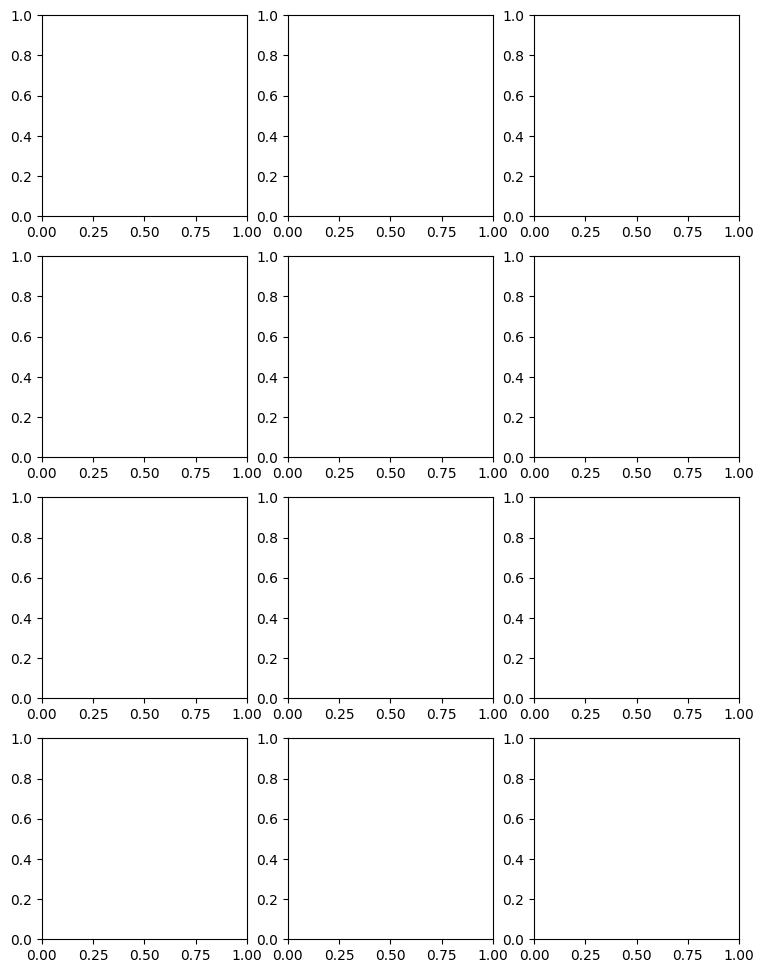

In [54]:
fig,axes = plt.subplots(4,3)
fig.set_size_inches(9,12)

for index, ax in enumerate(axes.flat):
  month_da = monthly_da.isel(month=index)
  month_da.sel(band=['red', 'green', 'blue']).plot,imshow(
      ax=ax,
      vmin=0,
      vmax=3000,
  )
  ax.set_title(f'{monthly_da.values}')
  ax.set_axis_off()

plt.tight_layout()
plt.show()